# Develop a Hand Gesture Recognition Model that can accurately identify and classify different hand gestures from image data, enabling intuitive human-computer interaction and gesture-based control systems.

In [1]:
import tensorflow as tf
print(tf.__version__)


2.16.1


In [2]:
#Importing Libaraies

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import os
import cv2
from tqdm import tqdm
import random
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.math import confusion_matrix
from sklearn.metrics import classification_report
import seaborn as sns
tf.random.set_seed(3)
import glob 
import skimage as oi
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dense, LeakyReLU


In [3]:
##Loading The Data

folders_names = []

for i in range(10):
    folder = os.path.join(r'/Users/souritachandra/Downloads/leapGestRecog', '0{}'.format(i))
    folders_names.append(folder)

files_names = ['01_palm', '02_l', '03_fist', '04_fist_moved', '05_thumb', '06_index', '07_ok', '08_palm_moved', '09_c', '10_down']

In [4]:
folders_names

['/Users/souritachandra/Downloads/leapGestRecog/00',
 '/Users/souritachandra/Downloads/leapGestRecog/01',
 '/Users/souritachandra/Downloads/leapGestRecog/02',
 '/Users/souritachandra/Downloads/leapGestRecog/03',
 '/Users/souritachandra/Downloads/leapGestRecog/04',
 '/Users/souritachandra/Downloads/leapGestRecog/05',
 '/Users/souritachandra/Downloads/leapGestRecog/06',
 '/Users/souritachandra/Downloads/leapGestRecog/07',
 '/Users/souritachandra/Downloads/leapGestRecog/08',
 '/Users/souritachandra/Downloads/leapGestRecog/09']

##Display 3 images for each file from eav=ch class

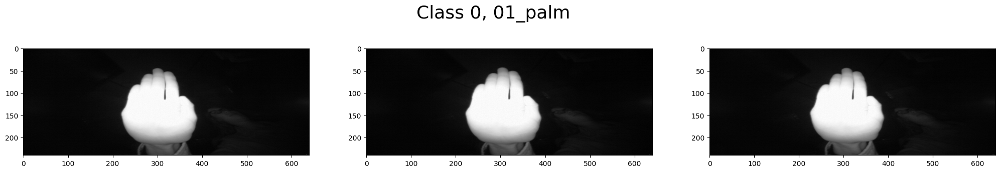

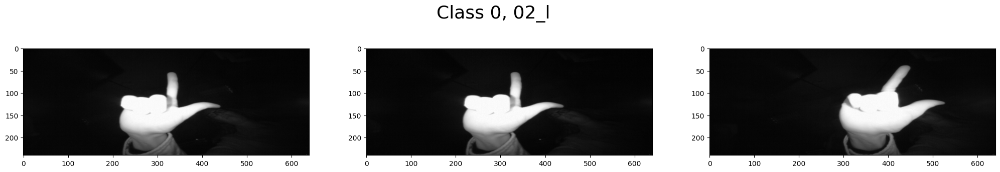

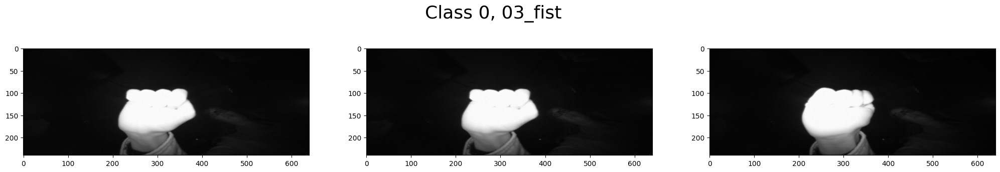

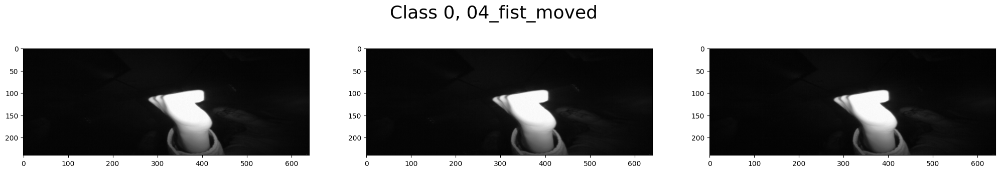

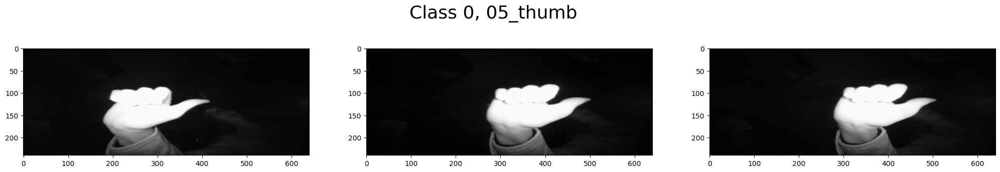

...

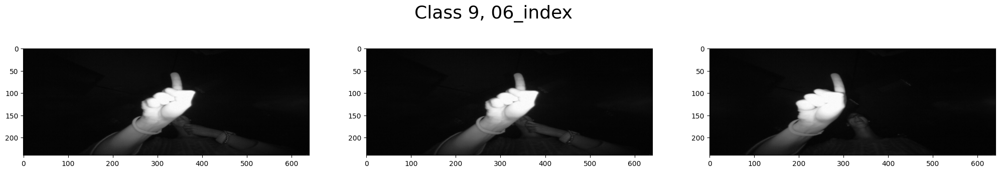

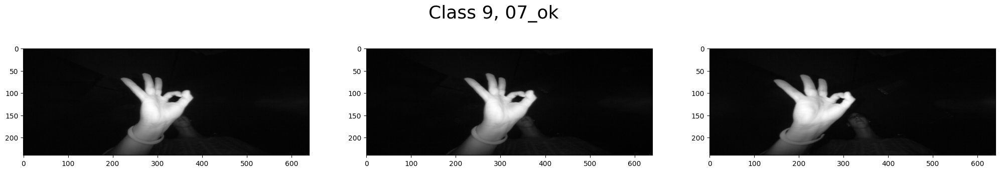

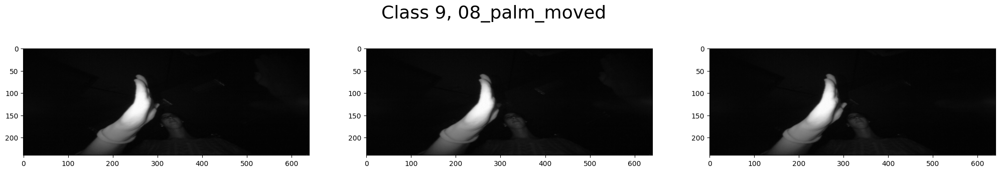

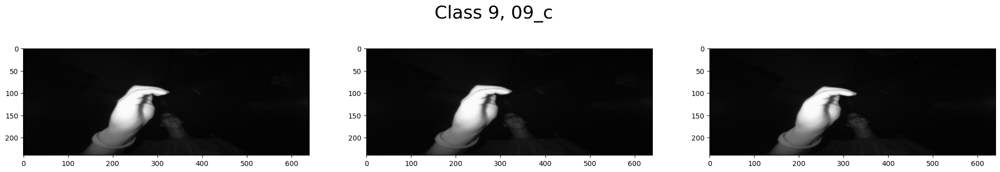

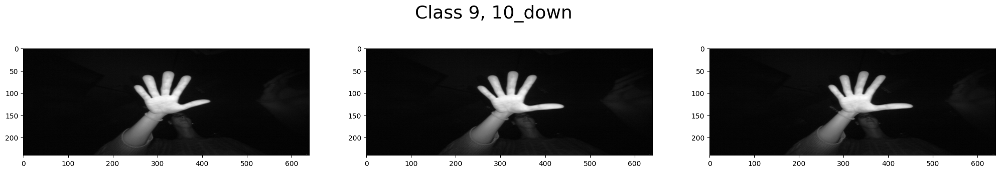

In [5]:
for folder in folders_names:
    class_num = folder[-1]
    for file in files_names:
        path = os.path.join(folder, file)
        if not os.path.exists(path):
            print(f"Path does not exist: {path}")
            continue

        x = 0
        fig, axes = plt.subplots(1, 3, figsize=(25, 4))
        manager = plt.get_current_fig_manager()
        manager.full_screen_toggle()  # Toggle full screen

        for img in os.listdir(path):
            img_path = os.path.join(path, img)
            img_array = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            if img_array is not None:
                axes[x].imshow(img_array, cmap='gray')
                x += 1
                if x == 3:
                    break

        plt.suptitle(f"Class {class_num}, {file}", fontsize=26)
        plt.show()

# Training data

In [6]:
training_data = []

def create_training_data():
    for folder in folders_names:
        Class_num=folder[-1]
        print('Class ' ,Class_num)
        for file in files_names:
            path = os.path.join(folder, file)

            print('Class ' ,Class_num,file)
#             c=0
            
            for img in tqdm(os.listdir(path)):
#                 if(c==100):
#                     break
#                 c+=1
                img_array = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                
          
                training_data.append([img_array,int(Class_num)])
                        
    
create_training_data()        

Class  0
Class  0 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 620.93it/s]


Class  0 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 596.70it/s]


Class  0 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 616.81it/s]


Class  0 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 591.06it/s]


Class  0 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 607.66it/s]


Class  0 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 594.07it/s]


Class  0 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 610.50it/s]


Class  0 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 623.22it/s]


Class  0 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 622.32it/s]


Class  0 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 627.83it/s]


Class  1
Class  1 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 612.83it/s]


Class  1 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 610.94it/s]


Class  1 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 655.02it/s]


Class  1 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 648.89it/s]


Class  1 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 647.72it/s]


Class  1 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 649.26it/s]


Class  1 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 640.77it/s]


Class  1 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 640.69it/s]


Class  1 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 641.77it/s]


Class  1 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 637.99it/s]


Class  2
Class  2 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 633.28it/s]


Class  2 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.63it/s]


Class  2 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 635.66it/s]


Class  2 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 642.75it/s]


Class  2 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 643.20it/s]


Class  2 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 645.14it/s]


Class  2 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 624.43it/s]


Class  2 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 605.20it/s]


Class  2 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 628.62it/s]


Class  2 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 635.87it/s]


Class  3
Class  3 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 613.16it/s]


Class  3 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 615.64it/s]


Class  3 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 641.26it/s]


Class  3 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 618.55it/s]


Class  3 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 612.43it/s]


Class  3 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 638.60it/s]


Class  3 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 628.27it/s]


Class  3 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 627.71it/s]


Class  3 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 612.05it/s]


Class  3 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 632.87it/s]


Class  4
Class  4 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 616.69it/s]


Class  4 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 635.92it/s]


Class  4 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 643.24it/s]


Class  4 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 629.44it/s]


Class  4 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 612.06it/s]


Class  4 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 626.85it/s]


Class  4 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 597.11it/s]


Class  4 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 625.37it/s]


Class  4 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.75it/s]


Class  4 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 627.43it/s]


Class  5
Class  5 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 635.41it/s]


Class  5 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.99it/s]


Class  5 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 617.31it/s]


Class  5 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 631.21it/s]


Class  5 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 648.31it/s]


Class  5 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 633.45it/s]


Class  5 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.05it/s]


Class  5 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 640.53it/s]


Class  5 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.37it/s]


Class  5 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 608.27it/s]


Class  6
Class  6 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 600.70it/s]


Class  6 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 546.45it/s]


Class  6 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 643.25it/s]


Class  6 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 644.39it/s]


Class  6 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 632.74it/s]


Class  6 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 630.10it/s]


Class  6 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 632.30it/s]


Class  6 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 633.56it/s]


Class  6 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 615.81it/s]


Class  6 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 612.49it/s]


Class  7
Class  7 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 636.95it/s]


Class  7 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 628.59it/s]


Class  7 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 627.45it/s]


Class  7 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 646.82it/s]


Class  7 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 633.37it/s]


Class  7 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 624.10it/s]


Class  7 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 642.06it/s]


Class  7 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 626.23it/s]


Class  7 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 624.02it/s]


Class  7 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 640.85it/s]


Class  8
Class  8 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 616.31it/s]


Class  8 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 626.03it/s]


Class  8 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 639.34it/s]


Class  8 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 627.28it/s]


Class  8 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 615.25it/s]


Class  8 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 626.05it/s]


Class  8 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 600.46it/s]


Class  8 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 599.50it/s]


Class  8 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 633.81it/s]


Class  8 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 628.75it/s]


Class  9
Class  9 01_palm


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 630.02it/s]


Class  9 02_l


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 629.24it/s]


Class  9 03_fist


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 622.55it/s]


Class  9 04_fist_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 622.44it/s]


Class  9 05_thumb


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 621.86it/s]


Class  9 06_index


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 598.04it/s]


Class  9 07_ok


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 582.41it/s]


Class  9 08_palm_moved


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 600.64it/s]


Class  9 09_c


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 616.09it/s]


Class  9 10_down


100%|████████████████████████████████████████| 200/200 [00:00<00:00, 619.41it/s]


##Sizes of images
##printing the shape of the first image from each class

In [7]:
for folder in folders_names:
    class_num = folder[-1]
    print('Class', class_num)
    for file in files_names:
        path = os.path.join(folder, file)
       
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
            print("Image shape:", img_array.shape,"\n")
            break  # To print only the first image shape for each file
        break  # To print only the first file shape for each folder

Class 0
Image shape: (240, 640) 

Class 1
Image shape: (240, 640) 

Class 2
Image shape: (240, 640) 

Class 3
Image shape: (240, 640) 

Class 4
Image shape: (240, 640) 

Class 5
Image shape: (240, 640) 

Class 6
Image shape: (240, 640) 

Class 7
Image shape: (240, 640) 

Class 8
Image shape: (240, 640) 

Class 9
Image shape: (240, 640) 



##Checking if all images have the same size or not

In [8]:
def check_image_sizes():
    first_img_shape = None
    for folder in folders_names:
        for file in files_names:
            path = os.path.join(folder, file)
            for img in os.listdir(path):
                img_array = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                if first_img_shape is None:
                    first_img_shape = img_array.shape
                elif img_array.shape != first_img_shape:
                    print("Image sizes are not consistent.")
                    return False
    print("All images have the same size:", first_img_shape)
   
check_image_sizes()

All images have the same size: (240, 640)


##Shuffling


In [9]:
##getting the classes of the first 10 images
for i in range(10):
    print("Class number for image", i+1, ":", training_data[i][1])

Class number for image 1 : 0
Class number for image 2 : 0
Class number for image 3 : 0
Class number for image 4 : 0
Class number for image 5 : 0
Class number for image 6 : 0
Class number for image 7 : 0
Class number for image 8 : 0
Class number for image 9 : 0
Class number for image 10 : 0


In [10]:
##getting the classes of the lastt 10 images

for i in range(-1, -11, -1):
    print("Class number for image", len(training_data) + i + 1, ":", training_data[i][1])

Class number for image 20000 : 9
Class number for image 19999 : 9
Class number for image 19998 : 9
Class number for image 19997 : 9
Class number for image 19996 : 9
Class number for image 19995 : 9
Class number for image 19994 : 9
Class number for image 19993 : 9
Class number for image 19992 : 9
Class number for image 19991 : 9


##Suffling and display the first 10 classes after suffling

In [11]:
random.shuffle(training_data)

for i in range(15):
    print(f"Sample {i+1}:")
    print("Class number:", training_data[i][1],"\n") 

Sample 1:
Class number: 5 

Sample 2:
Class number: 6 

Sample 3:
Class number: 4 

Sample 4:
Class number: 1 

Sample 5:
Class number: 4 

Sample 6:
Class number: 8 

Sample 7:
Class number: 9 

Sample 8:
Class number: 0 

Sample 9:
Class number: 1 

Sample 10:
Class number: 6 

Sample 11:
Class number: 8 

Sample 12:
Class number: 0 

Sample 13:
Class number: 9 

Sample 14:
Class number: 6 

Sample 15:
Class number: 5 



# Preprocessing

##Feature Selection

In [12]:
X=[]
y=[]

for feature,label in training_data:
    X.append(feature)
    y.append(label)
print(type(X))
print(type(y))

<class 'list'>
<class 'list'>


##Convert X ,y from list to numpy array

In [13]:
X=np.array(X)
y=np.array(y)
print(X.shape)
print(y.shape)

(20000, 240, 640)
(20000,)


##Spliting the Data

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=10)


print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(17000, 240, 640)
(17000,)
(3000, 240, 640)
(3000,)


In [15]:
##Getting classes names

print(np.unique(y_train))

print(np.unique(y_test))


[0 1 2 3 4 5 6 7 8 9]
[0 1 2 3 4 5 6 7 8 9]


In [16]:
##Scalling the Data

X_train = X_train/255
X_test = X_test/255
print(X_train[0])

[[0.02352941 0.02352941 0.02352941 ... 0.01568627 0.01568627 0.01960784]
 [0.01960784 0.01960784 0.01568627 ... 0.01960784 0.01960784 0.01960784]
 [0.01960784 0.01960784 0.02352941 ... 0.01568627 0.01568627 0.01176471]
 ...
 [0.01568627 0.01960784 0.01568627 ... 0.01568627 0.01568627 0.01568627]
 [0.01568627 0.01960784 0.02352941 ... 0.01568627 0.01568627 0.01568627]
 [0.01568627 0.01568627 0.01960784 ... 0.09803922 0.04705882 0.0627451 ]]


# Modeling The Data

In [17]:
##Building Multi Neural Network
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, LeakyReLU, Input

model = Sequential([
    Input(shape=(240, 640)),  # Define input shape with Input layer
    Flatten(),                # Flatten the input
    Dense(64),
    LeakyReLU(negative_slope=0.1),  # Use `negative_slope` instead of `alpha`
    Dense(32),
    LeakyReLU(negative_slope=0.1),
    Dense(16),
    LeakyReLU(negative_slope=0.1),
    Dense(10, activation='softmax')  # Output layer with 10 units for classification
])

In [18]:
##Compiling the model

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [19]:
##Training the Neural Network
try:
    history = model.fit(X_train, y_train, epochs=3, validation_split=0.1, batch_size=16, verbose=2)
except Exception as e:
    print(f"Error during model training: {e}")
    

Epoch 1/3
957/957 - 53s - 55ms/step - accuracy: 0.8368 - loss: 0.5803 - val_accuracy: 0.9535 - val_loss: 0.1451
Epoch 2/3
957/957 - 40s - 42ms/step - accuracy: 0.9637 - loss: 0.1087 - val_accuracy: 0.9800 - val_loss: 0.0436
Epoch 3/3
957/957 - 42s - 44ms/step - accuracy: 0.9620 - loss: 0.1234 - val_accuracy: 0.9647 - val_loss: 0.0799


 ##Model Summary

In [20]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 153600)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │     9,830,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 10)             │           170 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,499,728 (112.53 MB)

 Trainable params: 9,833,242 (37.51 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 19,666,486 (75.02 MB)

# Model Evaluation

##Training Loss

In [21]:
loss, accuracy = model.evaluate(X_train, y_train)
print(f"Training Loss: {loss:.4f}")
print(f"Training Accuracy: {accuracy*100:.2f}%")

532/532 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - accuracy: 0.9671 - loss: 0.0878
Training Loss: 0.0800
Training Accuracy: 96.98%


##Testing Loss

In [23]:
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Testing Loss: {loss:.4f}")
print(f"Testing Loss : {accuracy*100:.2f} %")

94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.9729 - loss: 0.1202
Testing Loss: 0.1073
Testing Loss : 96.83 %


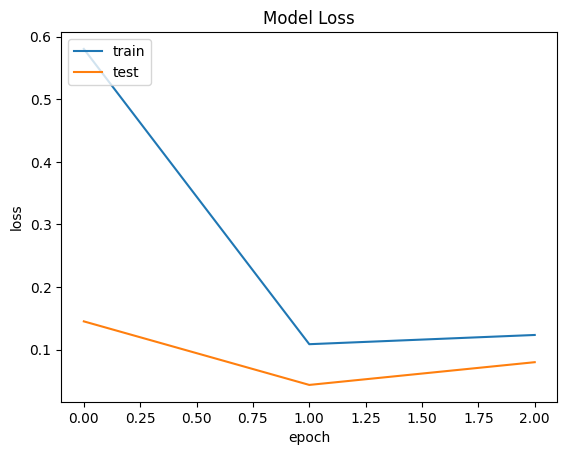

In [24]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

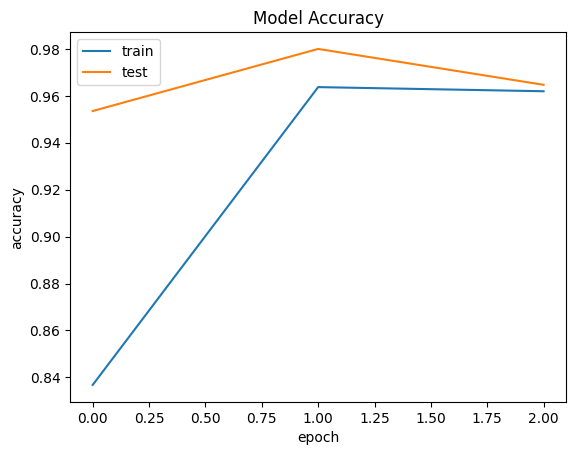

In [25]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# Prediction

In [26]:
y_pred=model.predict(X_test)
print(y_pred[0])

94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
[7.7466776e-29 5.8111651e-21 2.3257601e-04 1.2747417e-12 4.0699706e-09
 9.9976683e-01 3.5766062e-21 8.3825125e-15 5.4888903e-07 6.1925393e-14]
